In [25]:
# uncomment if gensim is installed
#!pip install gensim
import gensim
# Need the interactive Tools for Matplotlib
%matplotlib notebook
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA as sPCA
from sklearn import manifold #MSD, t-SNE
import re
from nltk.corpus import stopwords
import time
import math
from gensim.models import Word2Vec
from tqdm import tqdm

tqdm.pandas()
from sklearn.manifold import TSNE
import codecs
import multiprocessing
from gensim.models.phrases import Phraser, Phrases
import warnings
warnings.filterwarnings('ignore')
import os

## Loading Bank Fin Word Embeddings

In [21]:
model.wv.save_word2vec_format('embeddings/custom_finvec_100d.txt')

In [22]:
# loading bank fin word vectors:
model_gn = gensim.models.KeyedVectors.load_word2vec_format('embeddings/custom_finvec_100d.txt')

### Word Vector Representation

In [59]:
# Check out how particular financial term for e.g.,'credit' is represented (an array of 100 numbers)
model.wv.get_vector('credit')

array([ 1.0422076 , -0.65725195,  0.4966449 ,  1.0849847 , -0.74478567,
        2.5405571 , -1.0233756 , -1.9705049 ,  2.5647721 , -1.1101835 ,
       -2.491151  ,  2.6369956 ,  3.5130925 , -3.3911574 ,  0.06247789,
        0.18516757,  0.974691  ,  3.233541  , -0.7135056 , -1.3092042 ,
       -1.2968752 , -1.6933637 ,  1.7184362 ,  1.6035979 , -0.2506224 ,
        0.7815932 ,  0.5829453 , -0.17232707, -0.1986937 , -2.6563516 ,
       -0.96601933, -0.70893276,  2.140917  ,  2.4237077 , -2.5815072 ,
       -0.81725234,  0.1350472 ,  3.6702049 , -1.3490202 ,  1.3292286 ,
        1.6521642 , -0.49160495, -0.7052401 , -0.61018264, -1.6424685 ,
       -0.35160288,  1.1841685 , -1.4790365 ,  0.61606485,  0.6026303 ,
       -3.0675282 ,  1.3772169 ,  0.7907751 , -3.7008278 , -2.1867452 ,
        0.9619218 , -0.28306946, -0.5212931 , -1.3743751 , -0.6343776 ,
        0.56159216, -2.2403877 ,  1.3824421 , -1.8588381 , -0.37748116,
        1.3099619 , -1.1798166 ,  1.7531786 , -0.8069287 , -0.18

### Most similar words

In [60]:
# Find words with similar meaning to 'profit'
model.wv.most_similar('profit')

[('loss', 0.6887511014938354),
 ('revenue', 0.5218389630317688),
 ('sales', 0.5129647254943848),
 ('income', 0.503432035446167),
 ('profits', 0.4761982560157776),
 ('result', 0.4671795964241028),
 ('margin', 0.449984073638916),
 ('earnings', 0.44688522815704346),
 ('EUR', 0.4363775849342346),
 ('incomeprot', 0.4359431862831116)]

In [61]:
# Find words with similar meaning to 'investment'
model.wv.most_similar('investment')

[('investments', 0.4991505742073059),
 ('equity', 0.4843384623527527),
 ('investor', 0.4451677203178406),
 ('invested', 0.3764354884624481),
 ('size', 0.37316352128982544),
 ('corporate', 0.3702189326286316),
 ('commercial', 0.3693520724773407),
 ('insurance', 0.3531160354614258),
 ('lending', 0.3528694212436676),
 ('hedge', 0.34836554527282715)]

In [62]:
# Find words with similar meaning to 'liability'
model.wv.most_similar('liability')

[('liabilities', 0.510880708694458),
 ('income', 0.505390465259552),
 ('revolver', 0.49408453702926636),
 ('charges', 0.4685215950012207),
 ('exposure', 0.459900438785553),
 ('fee', 0.4530978798866272),
 ('lien', 0.44009387493133545),
 ('expense', 0.43753987550735474),
 ('loan', 0.4356876611709595),
 ('borrower', 0.4323517680168152)]

As we can see from above results, word embeddings have nice collection of banking terms and their most similar terms are also looks good. in the next step we will assess word embeddings through `word algebra`.

### Word Algebra

The core idea is that once words are represented as numerical vectors, you can do math with them. The mathematical procedure goes like this:

- Provide a set of words or phrases that you'd like to add or subtract.
- Look up the vectors that represent those terms in the word vector model.
- Add and subtract those vectors to produce a new, combined vector.
- Look up the most similar vector(s) to this new, combined vector via cosine similarity.
- Return the word(s) associated with the similar vector(s).
- But more generally, you can think of the vectors that represent each word as encoding some information about the meaning or concepts of the word. What happens when you ask the model to combine the meaning and concepts of words in new ways? Let's see.

In [27]:
def word_algebra(add=[], subtract=[], topn=1):
    """
    combine the vectors associated with the words provided
    in add= and subtract=, look up the topn most similar
    terms to the combined vector, and print the result(s)
    """
    answers = model.wv.most_similar(positive=add, negative=subtract, topn=topn)
    
    for term, similarity in answers:
        print(term)

#### Profit  - Sales  = Slipped

In [28]:
word_algebra(add=[u'profit'], subtract=[u'sales'])

slipped


#### Sales + Grow = Inflation

In [29]:
word_algebra(add=[u'sales', u'grow'])

inflation


#### Loan - Default = Prepayment

In [63]:
word_algebra(add=[u'loan'], subtract=[u'default'])

prepay


As we can see from word algebra that in bank fin word embeddings there is a logical relationship exist among different words.

In [23]:
keys = ['profit', 'investment', 'finance', 'shares', 'risk', 'assets', 'liability', 'credit', 'capital',
        'exposure','tax']

embedding_clusters = []
word_clusters = []
for word in keys:
    embeddings = []
    words = []
    for similar_word, _ in model_gn.most_similar(word, topn=30):
        words.append(similar_word)
        embeddings.append(model_gn[similar_word])
    embedding_clusters.append(embeddings)
    word_clusters.append(words)

In [24]:
embedding_clusters = np.array(embedding_clusters)
n, m, k = embedding_clusters.shape
tsne_model_en_2d = TSNE(perplexity=15, n_components=2, init='pca', n_iter=2500, random_state=32)
embeddings_en_2d = np.array(tsne_model_en_2d.fit_transform(embedding_clusters.reshape(n * m, k))).reshape(n, m, 2)

## Visualization of word vectors
In this section, we will explore a couple ways to visualize the word vector values to assess its performance.

However, we need to be careful in how we use these visualizations, since dimensions do not have any inherent meaning. The most we can do is use these visualizations to compare vectors, to see which components have similar values and which don't.

For the purposes of these visualizations, I am using normalized vectors (so the length of each vector is 1. This is also true of the preceding visualizations, but it was not relevant, since we were dealing with similarities of whole vectors, not the components of the vectors.

We will visualize vectors in following graphical methods:

1. 2D Scatterplots
2. 3D Scatterplots
3. Similarity Lines
4. Dimensionality reduction techniques
5. Color Encoding
6. Poly Lines

### 1. 2D scatterplots

In this visualization we will see the word embedding visualization of 11 selected financial words in 2 dimensions.

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

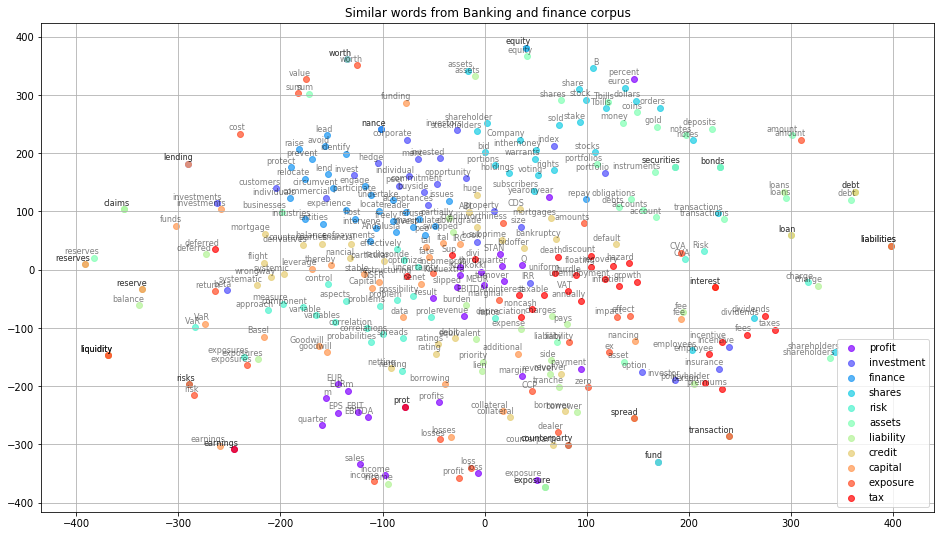

In [26]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
%matplotlib inline


def tsne_plot_similar_words(title, labels, embedding_clusters, word_clusters, a, filename=None):
    plt.figure(figsize=(16, 9))
    colors = cm.rainbow(np.linspace(0, 1, len(labels)))
    for label, embeddings, words, color in zip(labels, embedding_clusters, word_clusters, colors):
        x = embeddings[:, 0]
        y = embeddings[:, 1]
        plt.scatter(x, y, c=color, alpha=a, label=label)
        for i, word in enumerate(words):
            plt.annotate(word, alpha=0.5, xy=(x[i], y[i]), xytext=(5, 2),
                         textcoords='offset points', ha='right', va='bottom', size=8)
    plt.legend(loc=4)
    plt.title(title)
    plt.grid(True)
    if filename:
        plt.savefig(filename, format='png', dpi=150, bbox_inches='tight')
    plt.show()


tsne_plot_similar_words('Similar words from Banking and finance corpus', keys, embeddings_en_2d, word_clusters, 0.7,
                        'similar_words.png')

### 2. 3D scatterplot

In [50]:
words_wp = []
embeddings_wp = []
for word in list(model_gn.wv.vocab):
    embeddings_wp.append(model_gn.wv[word])
    words_wp.append(word)
    
tsne_wp_3d = TSNE(perplexity=30, n_components=3, init='pca', n_iter=2000, random_state=12)
embeddings_wp_3d = tsne_wp_3d.fit_transform(embeddings_wp)


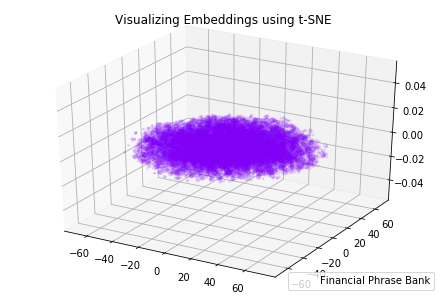

In [51]:
from mpl_toolkits.mplot3d import Axes3D


def tsne_plot_3d(title, label, embeddings, a=1):
    fig = plt.figure()
    ax = Axes3D(fig)
    colors = cm.rainbow(np.linspace(0, 1, 1))
    plt.scatter(embeddings[:, 0], embeddings[:, 1], embeddings[:, 2], c=colors, alpha=a, label=label)
    plt.legend(loc=4)
    plt.title(title)
    plt.show()


tsne_plot_3d('Visualizing Embeddings using t-SNE', 'Financial Phrase Bank', embeddings_wp_3d, a=0.1)

## Plotting GIFs

In [52]:
keys_gif = ['profit', 'investment', 'finance', 'shares', 'risk', 'assets', 'liability', 'credit', 'capital',
        'exposure','tax']

embedding_clusters_gif = []
word_clusters_gif = []
for word in keys:
    embeddings = []
    words = []
    for similar_word, _ in model_gn.most_similar(word, topn=200):
        words.append(similar_word)
        embeddings.append(model_gn[similar_word])
    embedding_clusters_gif.append(embeddings)
    word_clusters_gif.append(words)

In [53]:
embedding_clusters_gif = np.array(embedding_clusters_gif)
n, m, k = embedding_clusters_gif.shape

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

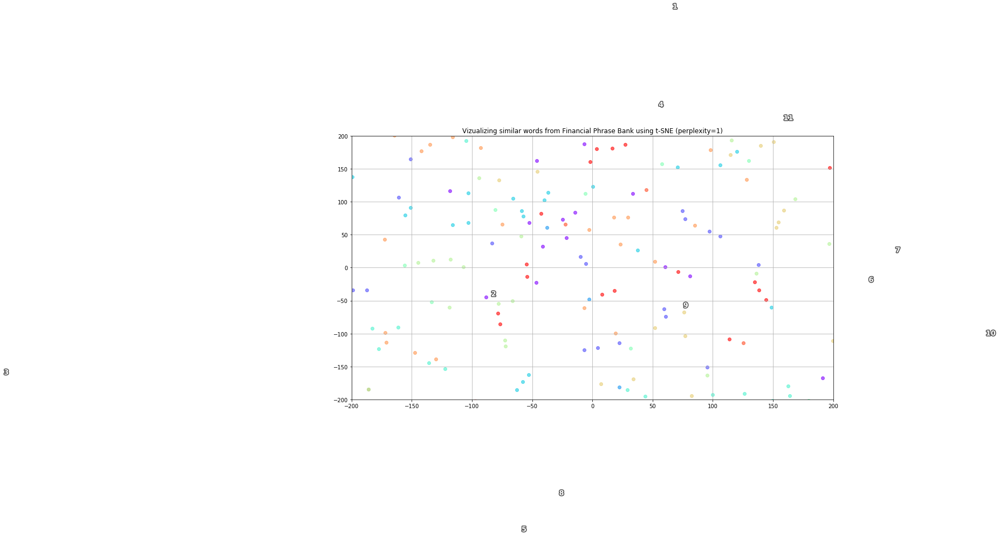

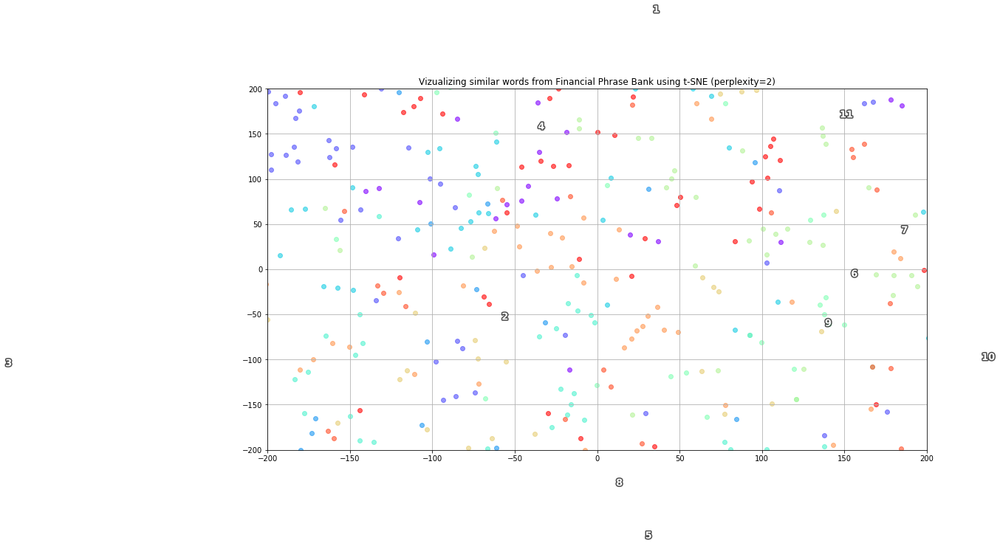

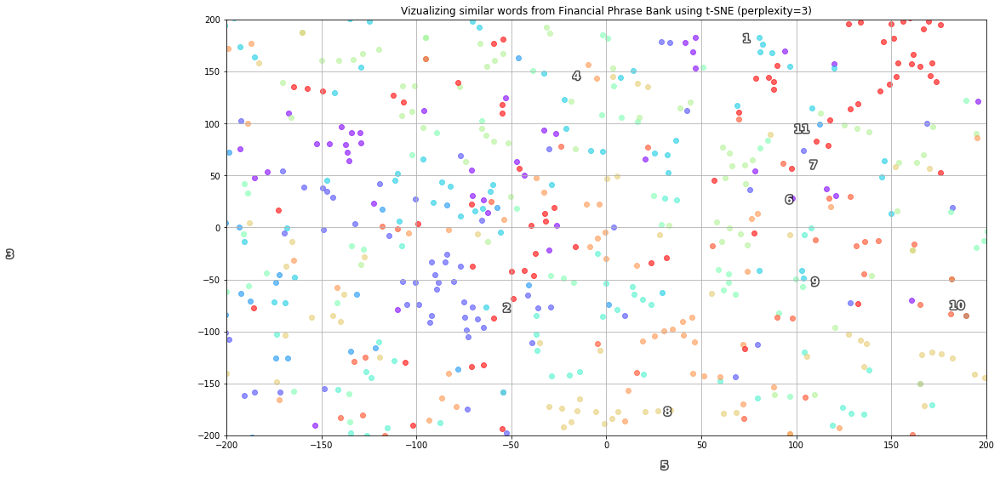

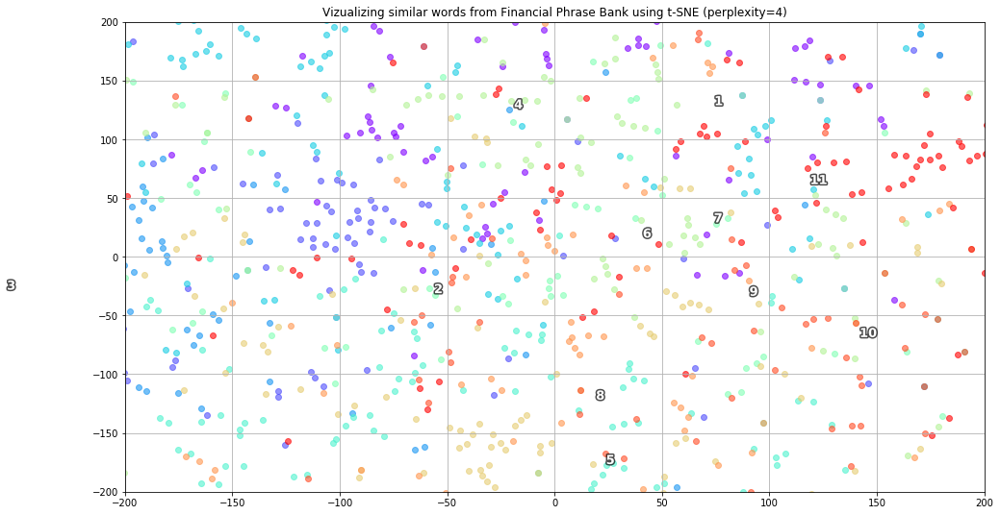

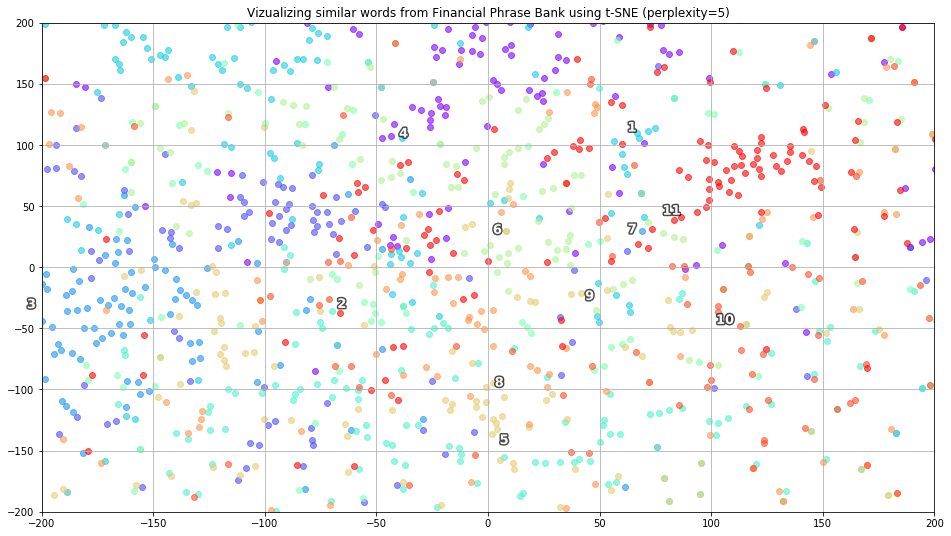

...

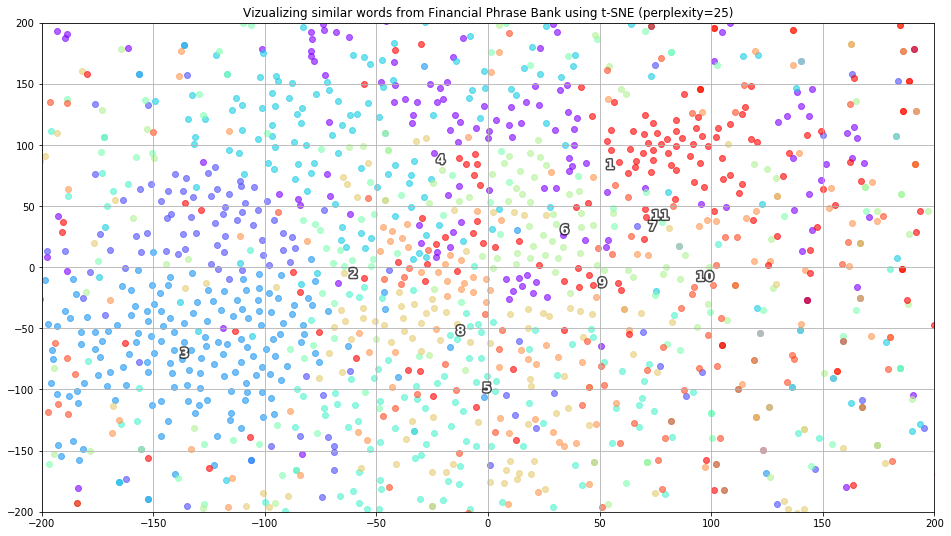

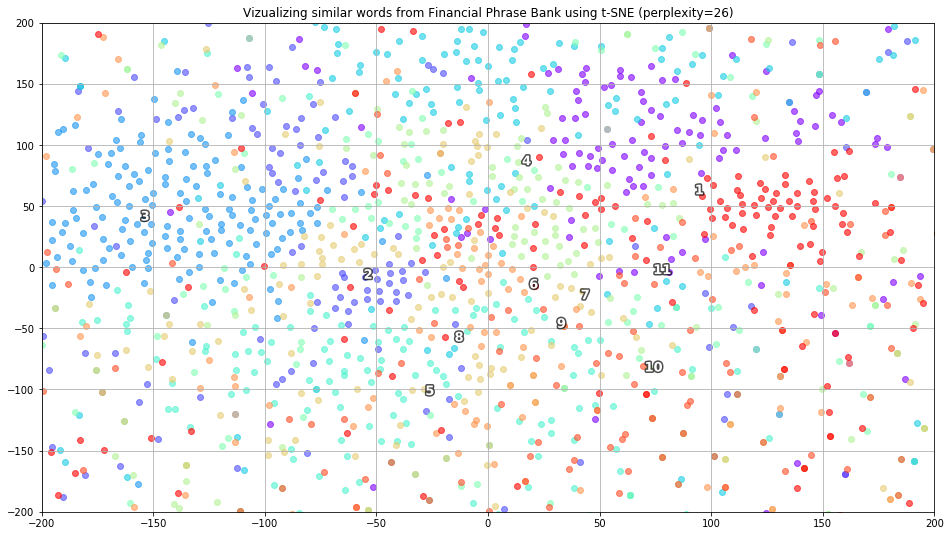

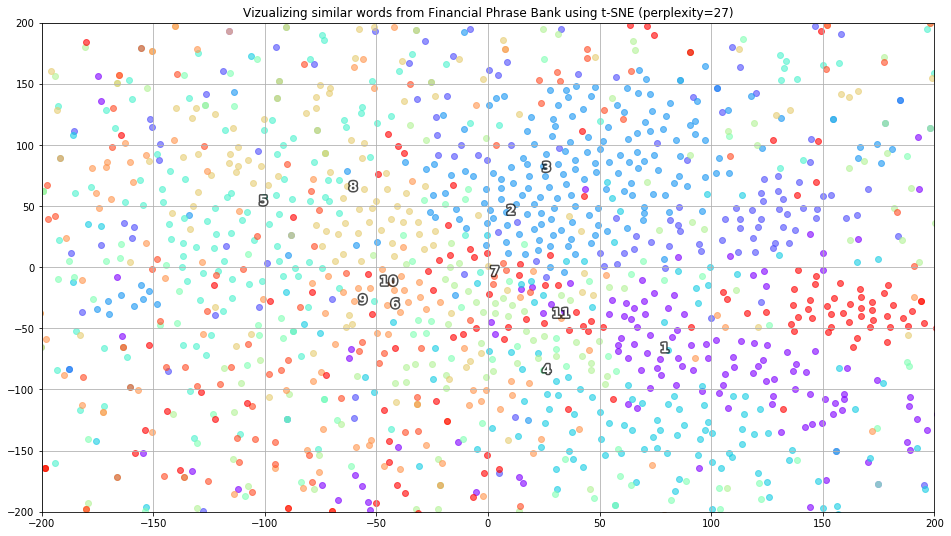

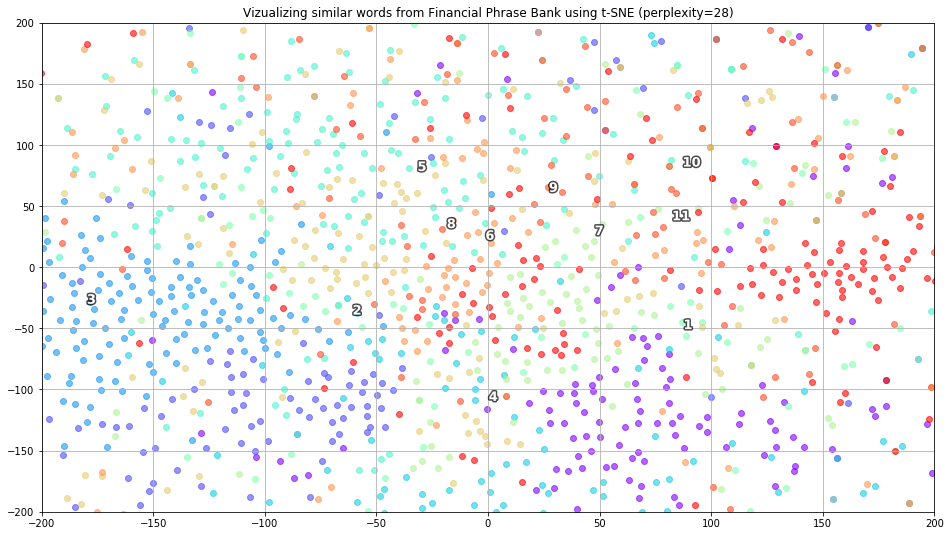

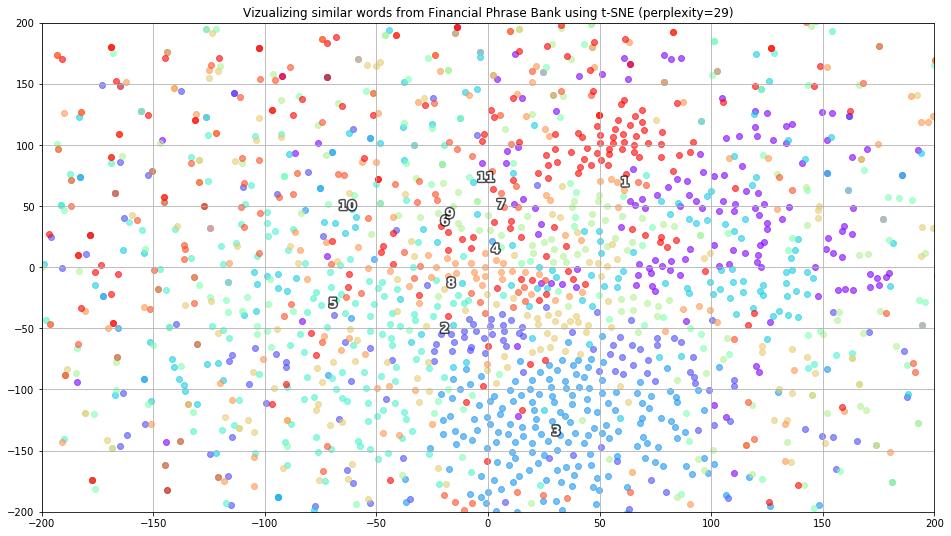

In [54]:
import matplotlib.patheffects as PathEffects
import tempfile
import imageio
import shutil

def tsne_plot_similar_words_png(title, embedding_clusters, a, filename):
    plt.figure(figsize=(16, 9))
    colors = cm.rainbow(np.linspace(0, 1, len(embedding_clusters)))
    i = 1
    for embeddings, color in zip(embedding_clusters, colors):
        x = embeddings[:, 0]
        y = embeddings[:, 1]
        plt.scatter(x, y, c=color, alpha=a)
        plt.text(x.mean(), y.mean(), str(i), color='white', weight='bold', fontsize=13, path_effects=[PathEffects.withStroke(linewidth=3,
                                                                          foreground="black", alpha=0.7)])
        i += 1
    plt.title(title)
    plt.grid(True)
    plt.xlim(-200, 200)
    plt.ylim(-200, 200)
    plt.savefig(filename, format='png', dpi=150, bbox_inches='tight')
    

dirpath = tempfile.mkdtemp()
images = []
for i in range(1, 30):
    fname = os.path.join(dirpath, str(i) + '.png')
    tsne_model_en_2d_gif = TSNE(perplexity=i, n_components=2, init='pca', n_iter=3500, random_state=32)
    embeddings_en_2d_gif = np.array(tsne_model_en_2d_gif.fit_transform(embedding_clusters_gif.reshape(n * m, k))).reshape(n, m, 2)
    tsne_plot_similar_words_png('Vizualizing similar words from Financial Phrase Bank using t-SNE (perplexity={})'.format(i), embeddings_en_2d_gif, 0.6, fname)
    images.append(imageio.imread(fname))
imageio.mimsave("bankfin_2d.gif", images, duration = 0.5)
shutil.rmtree(dirpath)

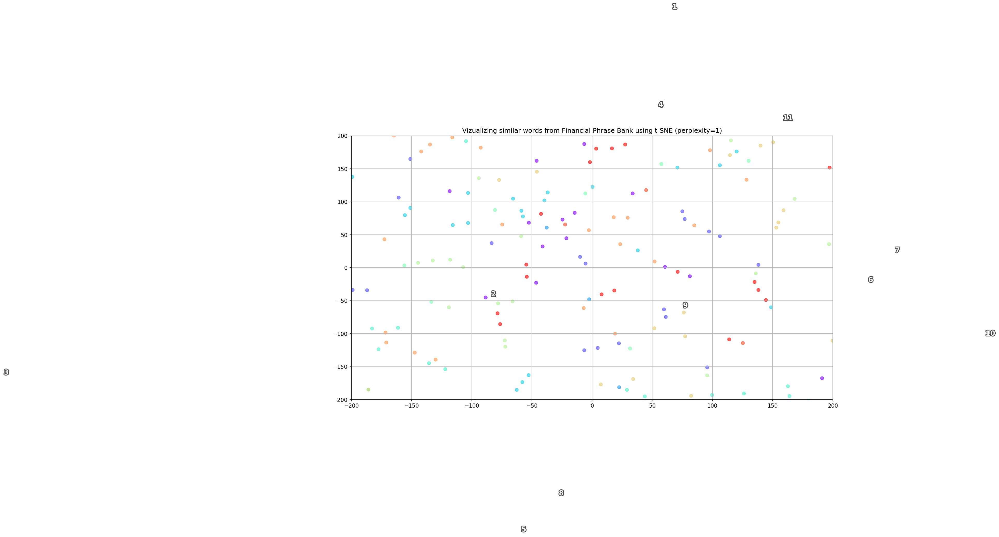

In [55]:
from IPython.display import Image
Image(filename="bankfin_2d.gif")

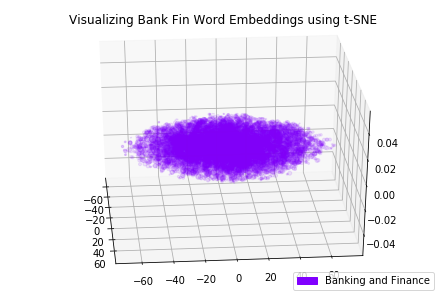

In [56]:
import matplotlib.patches as mpatches
import os


def tsne_plot_3d_gif(title, label, embeddings, filename, a):
    fig = plt.figure()
    ax = Axes3D(fig)
    colors = cm.rainbow(np.linspace(0, 1, 1))
    plt.scatter(embeddings[:, 0], embeddings[:, 1], embeddings[:, 2], c=colors, alpha=a)

    plt.title(title)

    red_patch = mpatches.Patch(color=colors[0], label=label)
    plt.legend(handles=[red_patch], loc=4)

    dirpath = tempfile.mkdtemp()
    images = []
    for angle in range(0, 360, 5):
        ax.view_init(30, angle)
        fname = os.path.join(dirpath, str(angle) + '.png')
        plt.savefig(fname, dpi=120, format='png', bbox_inches='tight')
        images.append(imageio.imread(fname))
    imageio.mimsave('3d.gif', images)
    shutil.rmtree(dirpath)


tsne_plot_3d_gif('Visualizing Bank Fin Word Embeddings using t-SNE', 'Banking and Finance',
                                  embeddings_wp_3d, 'bank_fin_3d.gif', 0.1)

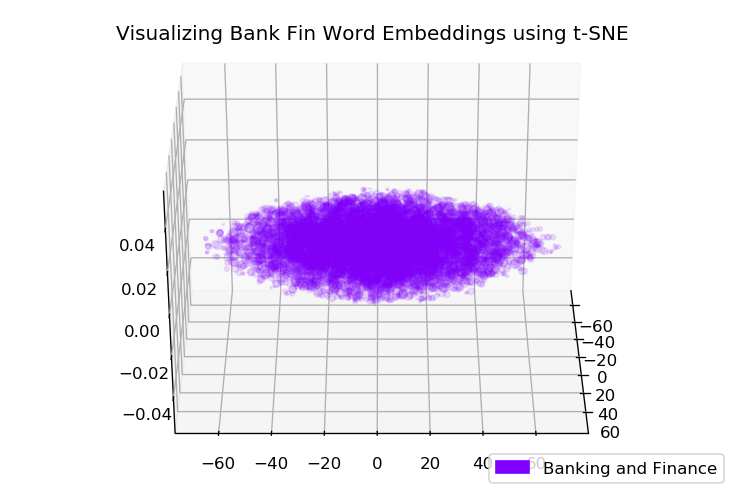

In [58]:
from IPython.display import Image
Image(filename="3d.gif")

### 3. Similarity Lines

Probably the most common use of visualization of word vectors is to get a sense of how similar words are. In the post on exploring similarities, we used one (uncommon) technique for visualizing similarties, namely plotting rank vs. similarity. (We then used the slope of those lines for further analysis, but that is not the point here.) Below we see the similarity line for the 10 words most similar to 'liquid', 'investment','capital','exposure'.

In [30]:
#for tables in Jupyter
from IPython.display import HTML, display
import tabulate

In [31]:
def show_closest_line(vecs,word,n):
    display(HTML("<b>%d words most similar to '%s'</b>" % (n,word)))
    
    tops = vecs.similar_by_word(word, topn=n, restrict_vocab=None)
    
    items = [item[0] for item in tops]
    sims = [item[1] for i,item in enumerate(tops)]
    
    fig = plt.figure(num=None, figsize=(10, 6), dpi=80, facecolor='w', edgecolor='k')
    ax = fig.add_subplot(111)

    
    plt.xticks(range(n), [i+1 for i in range(n)])
    plt.xlabel('Rank')
    plt.ylabel('Similarity')
    plt.xlim(-1,n)

    
    ax.plot(sims, color="purple", alpha=0.5)
    
    for item, x, y in zip(items, range(n), sims):
        ax.annotate( item, xy=(x, y), xytext=(20, -7), textcoords='offset points', 
                     ha='right', va='bottom', color='orange', fontsize=14 )

    
    
    
    plt.show()

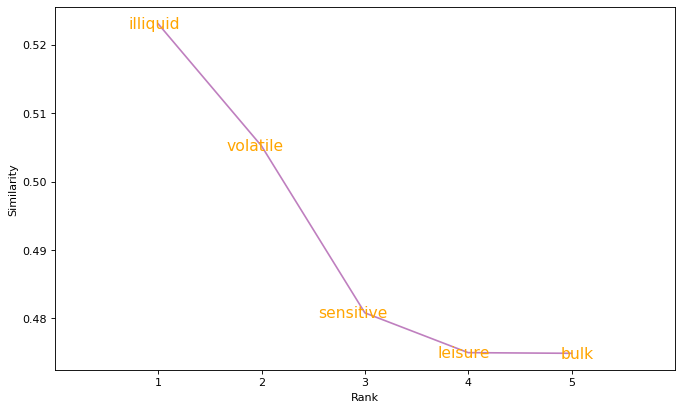

In [32]:
show_closest_line(model,'liquid',5)

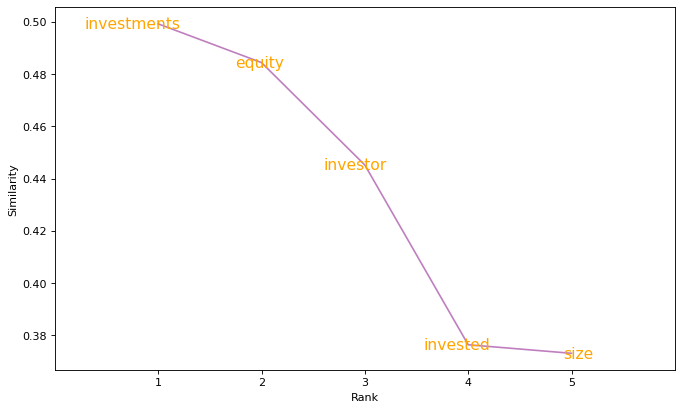

In [35]:
show_closest_line(model,'investment',5)

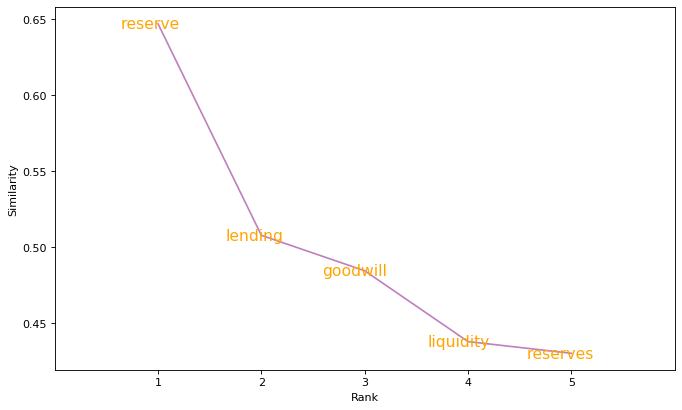

In [36]:
show_closest_line(model,'capital',5)

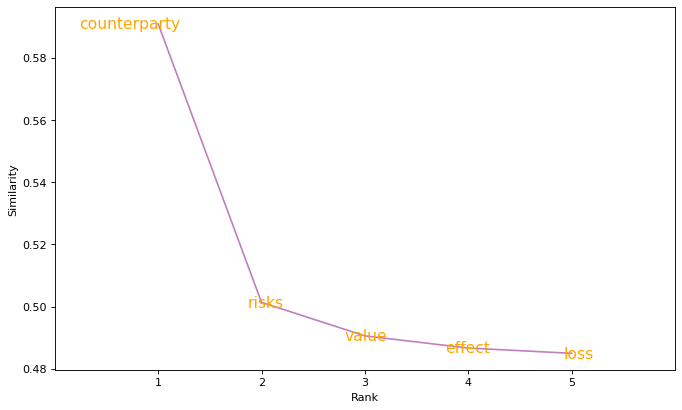

In [37]:
show_closest_line(model,'exposure',5)

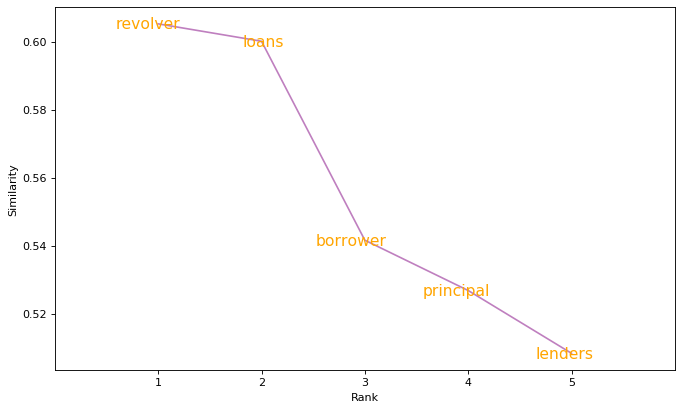

In [38]:
show_closest_line(model,'loan',5)

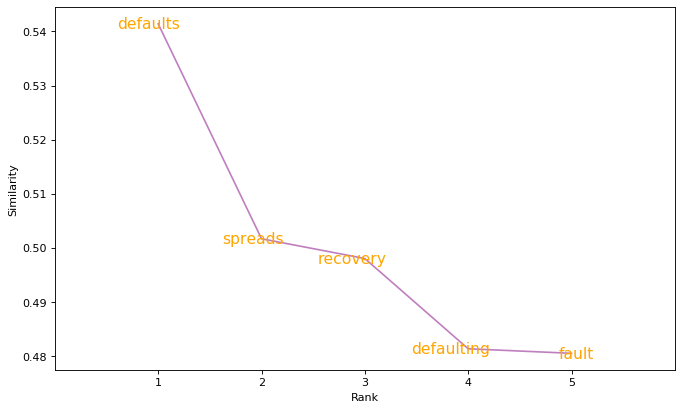

In [39]:
show_closest_line(model,'default',5)

A large advantage of similarity lines is that they are easily interpretable: rank and similarity are familiar ideas and they are encoded straightforwardly by position (horizontal and vertical, respectively).

The main disadvantage of similarity lines is that show us only one aspect of similarity, namely similarity to a single given word ('house' in this example). We cannot tell anything about the similarity of these words to each other.

To see why this is so, consider a geographic example. The distance from London, England to the closest European capital, Paris, France, is 460km, while the distance from London to the second closest European capital, Dublin, Ireland, is 557km. However, the distance from Paris to Dublin is not 97km (557-460), but rather 1024km.

The problem is that in both the geographic example and word vectors, distance/similarity is one dimensional but the data is multi-dimensional (location involves orientation, not just distance), so some information is lost when representing the original data with a single dimension.

### 4. Dimensionality Reduction Techniques

A common technique when dealing with high dimensionsal data is to reduce the number of dimensions by transforming the data into a lower number of new dimensions for visualization. The number of dimensions is usually two, sometimes three, given our two dimensional displays. There are many ways to do dimensionality reduction, each with their own goals and motivations, but I will focus on three common techniques, using just two dimensions for illustration.

- **Principal Components Analysis (PCA)**
- **Multidimensional Scaling (MDS)**
- **t-distributed Stochastic Neighbor Embedding (t-SNE)**

It is important to note that these techniques are mathematical transformations and not visualization techniques: the results of the transformations are used for visualization. In fact, the function I wrote below to illustrate these techniques calculates the transformation in each case, and then uses exactly the same code for the visualizations.

An additional point is that the new dimensions of the transformed data do not have any inherent meaning relative to the original data, which is why there are no scales in the charts below.

In [40]:
def show_closest_2d(vecs,word,n,method):
    tops = vecs.similar_by_word(word, topn=n, restrict_vocab=None)
    
    display(HTML("<b>%d words most similar to '%s' (%s)</b>" % (n,word, method)))
    #display(HTML(tabulate.tabulate(tops, tablefmt='html', headers=[])))

    items = [word] + [x[0] for x in tops]

    wvecs = np.array([vecs.word_vec(wd, use_norm=True) for wd in items])

    if method is "PCA":
        spca = sPCA(n_components=2)
        coords = spca.fit_transform(wvecs)
        #print('Explained variation per principal component:', spca.explained_variance_ratio_, "Total:", sum(spca.explained_variance_ratio_))
    
    elif method is "tSNE":
        tsne = manifold.TSNE(n_components=2)
        coords = tsne.fit_transform(wvecs)
        #print("kl-divergence: %0.8f" % tsne.kl_divergence_)
        
    elif method == "tSNE-PCA":
        tsne = manifold.TSNE(n_components=2, init='pca')
        coords = tsne.fit_transform(wvecs)
        #print("kl-divergence: %0.8f" % tsne.kl_divergence_)
    
    elif method is "MDS":
        dists = np.zeros((len(items), len(items)))
        for i,item1 in enumerate(items):
            for j,item2 in enumerate(items):
                dists[i][j] = dists[j][i] = vecs.distance(item1,item2)
        
        mds = manifold.MDS(n_components=2, max_iter=3000, eps=1e-9, random_state=0, dissimilarity="precomputed", n_jobs=1)
        coords = mds.fit(dists).embedding_
        #print("Stress is %0.8f" % mds.stress_)

    else:
        raise ValueError("Invalid method: %s" % method) 

    plt.figure(num=None, figsize=(8, 8), dpi=80, facecolor='w', edgecolor='k')
    plt.tick_params(
        axis='both',          
        which='both',      
        bottom=False,      
        left=False,         
        labelbottom=False,
        labelleft=False)

    lim = max([abs(x) for x in coords[:,0] + coords[:,1]])
    plt.xlim([-lim,lim])
    plt.ylim([-lim,lim])
    plt.scatter(coords[2:,0], coords[2:,1])
    plt.scatter(coords[0:1,0], coords[0:1,1], color='black')
    plt.scatter(coords[1:2,0], coords[1:2,1], color='orange')
    
    for item, x, y in zip(items[2:], coords[2:,0], coords[2:,1]):
        plt.annotate( item, xy=(x, y), xytext=(-2, 2), textcoords='offset points', 
                     ha='right', va='bottom', color='purple', fontsize=14 )

    x0=coords[0,0]
    y0=coords[0,1]
    plt.annotate( word , xy=(x0, y0), xytext=(-2, 2), textcoords='offset points', 
                 ha='right', va='bottom', color='black', fontsize=16 )
    
    x1=coords[1,0]
    y1=coords[1,1]
    plt.annotate( items[1] , xy=(x1, y1), xytext=(-2, 2), textcoords='offset points', 
                 ha='right', va='bottom', color='orange', fontsize=14 )

    ax = plt.gca()
    
    r = math.sqrt( (x1-x0)**2 + (y1-y0)**2 )
    
    circle = plt.Circle((x0, y0), r, color='orange', fill=False)
    ax.add_artist(circle)

    plt.show()

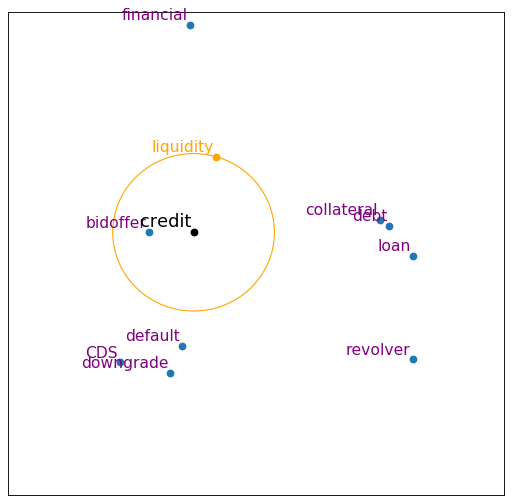

In [41]:
show_closest_2d(model.wv,'credit',10,'PCA')

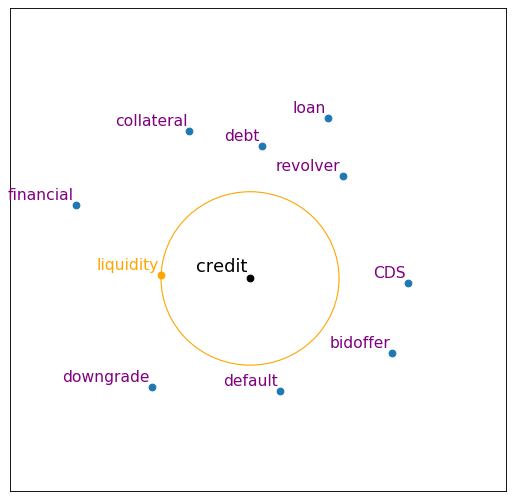

In [42]:
show_closest_2d(model.wv,'credit',10,'MDS')

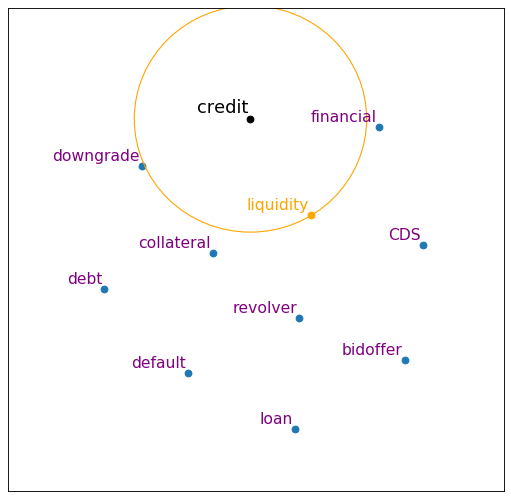

In [43]:
show_closest_2d(model.wv,'credit',10,'tSNE')

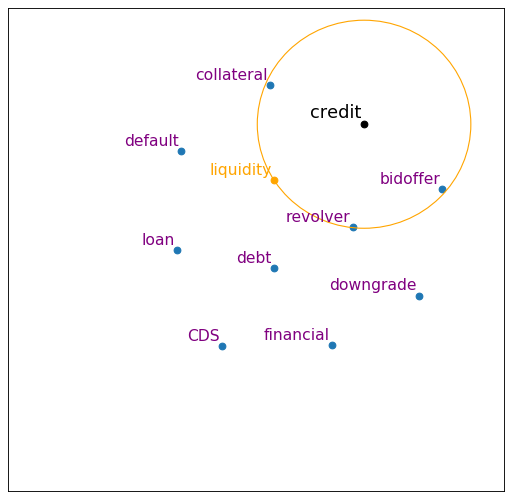

In [44]:
show_closest_2d(model.wv,'credit',10,'tSNE-PCA')

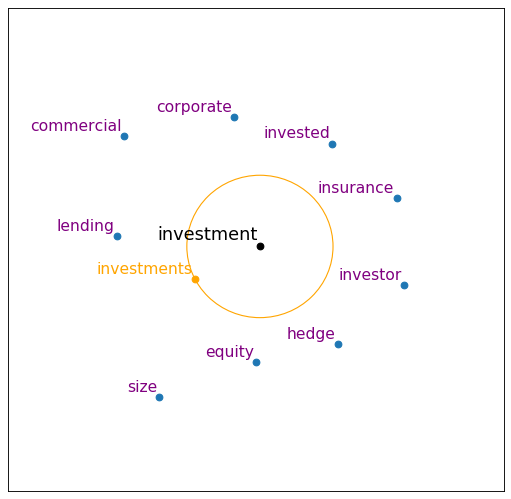

In [45]:
show_closest_2d(model.wv,'investment',10,'MDS')

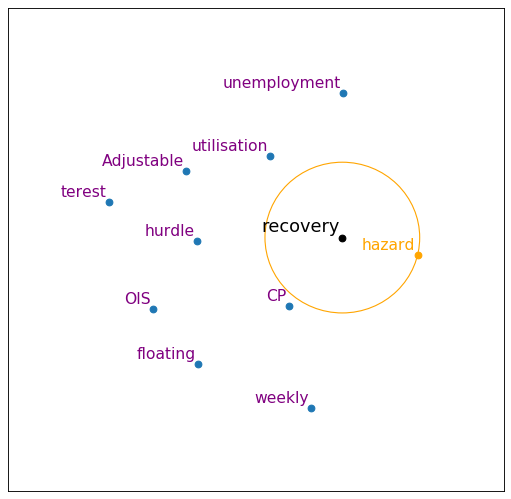

In [46]:
show_closest_2d(model.wv,'recovery',10,'MDS')

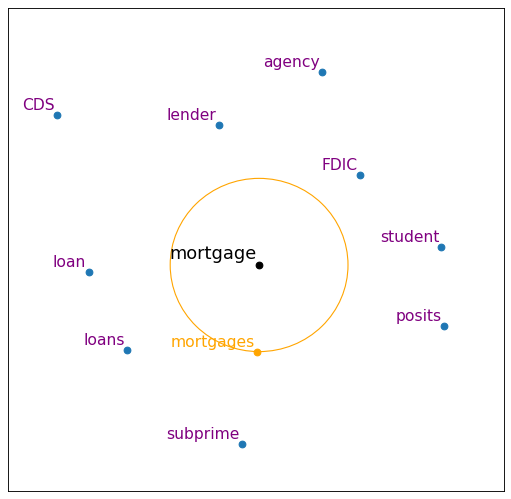

In [47]:
show_closest_2d(model.wv,'mortgage',10,'MDS')

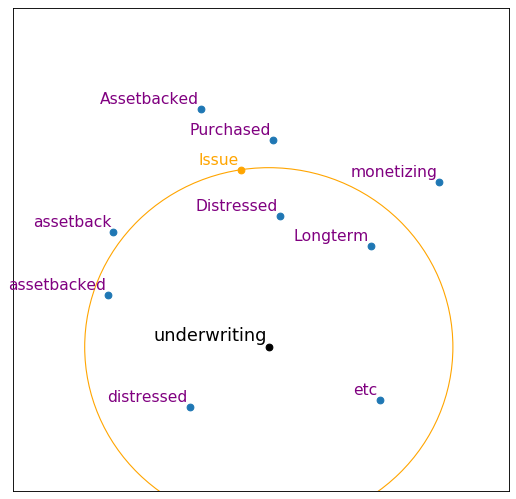

In [48]:
show_closest_2d(model.wv,'underwriting',10,'MDS')

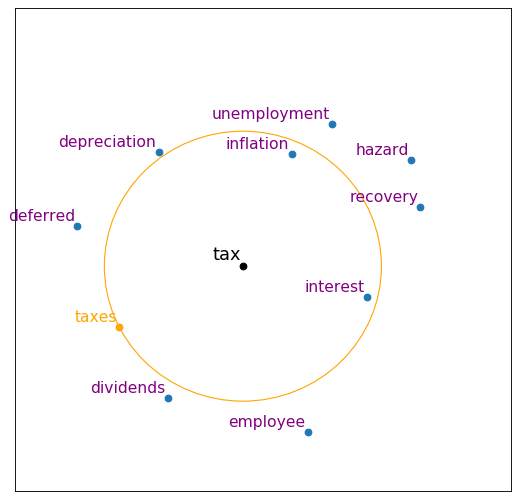

In [49]:
show_closest_2d(model.wv,'tax',10,'MDS')

##### Evaluating dimensionality reduction techniques

The main advantage of using dimensionality reduction is that the results can give us an idea of groupings of words in a way that the similarity lines cannot. However, given that it is in general impossible to preserve all of the distances in a high dimensional space when we reduce it down to a lower number of dimensions, the groupings we see in the reduced version must be taken with a grain of salt, as can be seen from the differences across the different techniques. The choice of dimensionality reduction technique thus depends on external factors, such as speed. It might also be prudent to try more than one, as we have done here.

### 5. Encoding with color

One simple way to visualize the components of vectors is to assign each value a color, and then show them as shapes along a horizontal axis, representing the dimensions. In the first example below, we'll use 'house' and some of its most similar words, from the example above.

In [64]:
def compare_words_with_color(vecs,wds):
    wdsr = wds[:]
    wdsr.reverse()
    
    display(HTML('<b>Word vectors for: %s</b>' % ', '.join(wdsr)))
    
    vs = [vecs.get_vector(wd) for wd in wds]
    dim = len(vs[0])
    
    fig = plt.figure(num=None, figsize=(12, 2), dpi=80, facecolor='w', edgecolor='k')
    ax = fig.add_subplot(111)
    ax.set_facecolor('gray')
    
    for i,v in enumerate(vs):
        ax.scatter(range(dim),[i]*dim, c=vs[i], cmap='Spectral', s=16)
    
    #plt.xticks(range(n), [i+1 for i in range(n)])
    plt.xlabel('Dimension')
    plt.yticks(range(len(wds)), wds)
    
    
    plt.show()

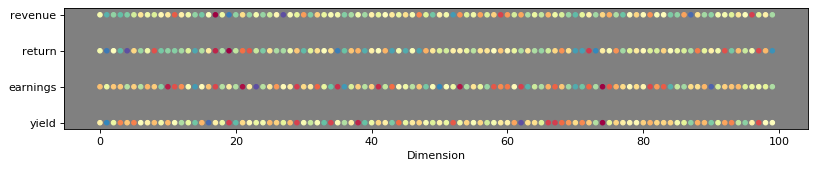

In [65]:
words_revenue = ['revenue','return','earnings','yield']
words_revenue.reverse()
compare_words_with_color(model.wv,words_revenue)

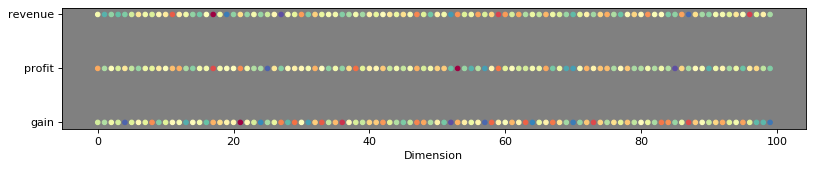

In [69]:
words_amort = ['revenue','profit','gain']
words_amort.reverse()
compare_words_with_color(model.wv,words_amort)

mpressionistcally, there is a lot of similartiy in the values of the components, not surprisingly. On the other hand, when we look at words that are semantically related ('revenue','profit','gain'), it's harder to see similarities in the values.

### 6. Encoding as polylines

In the color encoding technique, the dimensions are represented on the horizontal axis, while the values are represented by color. An alternative for the values is the represent them on the vertical axis, connecting the components of a single vector by line segments (a polyline). This technique borrows from the parallel coordinates visualization. Once again, the difference here is that unlike typical uses of parallel coordinates, our components/axes do not have any inherent meaning.

Here's a version in parallel coordinates style, with all the vectors represented in the same chart.



In [70]:
def compare_words_polyline(vecs,wds,combined=True):
    
    display(HTML('<b>Word vectors for: %s</b>' % ', '.join(wds)))
    
    vs = [vecs.get_vector(wd) for wd in wds]
    dim = len(vs[0])
    nseries = len(wds)

    colormap = plt.cm.tab20b
    colors = [colormap(i) for i in np.linspace(0, 1, nseries)]

    
    if combined:
        fig = plt.figure(num=None, figsize=(12, 6), dpi=80, facecolor='w', edgecolor='k')
        ax = fig.add_subplot(111)

        for i,v in enumerate(vs):
            ax.plot(v, label=wds[i], c=colors[i])

        ax.legend(loc=2)
        
    else:
        fig, axarr = plt.subplots(nseries+1, sharex=True, sharey=True, figsize=(12, 2+nseries), dpi=80, facecolor='w', edgecolor='k')

        for i,v in enumerate(vs):
            axarr[i+1].plot(v, label=wds[i], c=colors[i])
        
        axarr[0].axis('off')
        
        fig.legend(loc=9)
        fig.tight_layout()
 

    plt.xlabel('Dimension')
    plt.ylabel('Value')
    
    plt.show()